<a href="https://colab.research.google.com/github/jimohafeezco/computer_vision/blob/master/Object_tracking_with_OpenCV_and_SSD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Introduction to Computer Vision (Spring 2020)
Instructor: Muhammad Fahim \\
TA: Marcus Ebner

### Acknowledgement
This lab was maintained by Marcus

# Object Tracking


In [1]:
from IPython.display import clear_output
import cv2
import sys
%matplotlib inline
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (16, 10) # (w, h)
import numpy as np
import time
import math
from google.colab.patches import cv2_imshow
import imutils
# !pip install tf-nightly-gpu-2.0-preview

# For running inference on the TF-Hub module.
import tensorflow as tf
import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
clear_output()

In [2]:
!wget "https://drive.google.com/uc?export=view&id=1skt6SmYqjQ_jWh4jIkpe3njILEIaS72-" -O vid.mp4
!wget "https://drive.google.com/uc?id=1Ckgprba7Yd6a-nQQi9AfXvSEGsEZXpcz&authuser=0&export=download" -O cars.mp4

--2020-09-15 20:08:57--  https://drive.google.com/uc?export=view&id=1skt6SmYqjQ_jWh4jIkpe3njILEIaS72-
Resolving drive.google.com (drive.google.com)... 74.125.195.139, 74.125.195.102, 74.125.195.138, ...
Connecting to drive.google.com (drive.google.com)|74.125.195.139|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0c-7s-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8bftm5k2ina6lr6vk2gfittok3r5bh3j/1600200525000/17396682441590382856/*/1skt6SmYqjQ_jWh4jIkpe3njILEIaS72-?e=view [following]
--2020-09-15 20:08:58--  https://doc-0c-7s-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8bftm5k2ina6lr6vk2gfittok3r5bh3j/1600200525000/17396682441590382856/*/1skt6SmYqjQ_jWh4jIkpe3njILEIaS72-?e=view
Resolving doc-0c-7s-docs.googleusercontent.com (doc-0c-7s-docs.googleusercontent.com)... 74.125.20.132, 2607:f8b0:400e:c07::84
Connecting to doc-0c-7s-docs.googleusercontent.com (doc-0c-7s-docs.goog

## Helper functions

In [3]:
def show_in_row(list_of_images, titles = None, disable_ticks = False):
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(1, count, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])
      
    img = list_of_images[idx]
    cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
    subplot.imshow(img)
    if disable_ticks:
      plt.xticks([]), plt.yticks([])
  plt.show()
  

Additional functions

In [4]:
def detect_red(frame):
  """
  Detects the largest red object in the frame and returns its bounding box.
  """
  state = []
  # print(frame)
  track_frame = cv2.inRange(frame.copy(), (0, 0, 140), (60, 60, 255))
  track_frame = cv2.dilate(track_frame, np.ones((39,39), np.uint8))
  track_frame = cv2.erode(track_frame, np.ones((29,29), np.uint8))
  
  contour = cv2.findContours(track_frame, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  contour = imutils.grab_contours(contour)
  if len(contour)>0:
    c = max(contour, key=cv2.contourArea)
    (cent_x, cent_y), radius = cv2.minEnclosingCircle(c)
    cent_x, cent_y, radius = int(cent_x),int(cent_y), int(radius)
    state.append((cent_x-radius, cent_y-radius, 2*radius, 2*radius))
    # if (4*radius*radius)>10:
      # state = []
  return state


def create_tracker(tracker_type='KCF'):
  if tracker_type == 'BOOSTING':
      tracker = cv2.TrackerBoosting_create()
  elif tracker_type == 'MIL':
      tracker = cv2.TrackerMIL_create()
  elif tracker_type == 'KCF':
      tracker = cv2.TrackerKCF_create()
  elif tracker_type == 'TLD':
      tracker = cv2.TrackerTLD_create()
  elif tracker_type == 'MEDIANFLOW':
      tracker = cv2.TrackerMedianFlow_create()
  elif tracker_type == 'GOTURN':
      tracker = cv2.TrackerGOTURN_create()
  elif tracker_type == 'MOSSE':
      tracker = cv2.TrackerMOSSE_create()
  elif tracker_type == "CSRT":
      tracker = cv2.TrackerCSRT_create()
  else:
      print("No valid tracker type given! Using type 'KCF'.")
      tracker = cv2.TrackerKCF_create()

  return tracker

## Detecting and Tracking of a Single Object

In [5]:
import imutils
import sys

# global init_once = False
def track(video, frame, bbox, output_writer, num_frames=5):
  """
  Tracks given object for num_frames frames, draws a bounding box around the object
  and writes those frames to an output.
  """
  # bbox=None
  # print(bbox)
  # fps=None  
  # Create and initialize a tracker using the function from above
  # See documentation for cv::Tracker to see how to initialize it
  # < your code here >
  tracker_type='KCF'
  tracker= create_tracker(tracker_type=tracker_type)
  if bbox ==[]:
    box1 = (120,23,45,60)

    tracker.init(frame, box1)

  # ok, frame = video.read()
  # counter= 0
  init_once = False

  for i in range(num_frames):
    ok, frame = video.read()

    # print(ok)
    if not ok:
        print("[function 'track'] Error reading frame from video!")
        break
        # sys.exit()

    # if bbox is not None:
      # grab the new bounding box coordinates of the object
    (success, box) = tracker.update(frame)
    # check to see if the tracking was a success
    # print(success, box)
    # print(box)
    (H, W) = frame.shape[:2]
    if bbox != []:
      p1 = (int(bbox[0][0]), int(bbox[0][1]))
      p2 = (int(bbox[0][0] + bbox[0][2]), int(bbox[0][1] + bbox[0][3]))
      cv2.rectangle(frame, p1, p2, (255,0,0), 2, 1)
    # update the FPS counter
    # fps.update()
    # fps.stop()
    # initialize the set of information we'll be displaying on
    # the frame
    info = [
      ("Tracker", tracker_type),
      ("Success", "Yes" if success else "No")
      # ("FPS", "{:.2f}".format(fps.fps())),
    ]
    # loop over the info tuples and draw them on our frame
    for (i, (k, v)) in enumerate(info):
      text = "{}: {}".format(k, v)
      cv2.putText(frame, text, (10, H - ((i * 20) + 20)),
        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2) 
  if frame is not None:
    # show_in_row([frame])
    return frame
  # output_writer.write(frame)
  # cv2.imshow([frame])


def detect_object_and_track(path, output_writer, num_frames):
  """
  Opens a video, tries to detect a large, red object and then tries to track it
  for the next num_frames frames and draw a bounding box around it.
  """
  video = cv2.VideoCapture(path)

  # print(video)
  try:
    while(True):
      ret, frame = video.read()
      # show_in_row([frame])
      # if not init_once:
      #     ok = tracker.init(image, bbox)
      #     init_once = True
      # print(ret)
      if not ret:
        print("[function 'detect_object_and_track'] Error reading frame from video!")
        video.release()
        break
      # print("a",frame)
      bbox=detect_red(frame)
      # print(bbox)
      # for i in box:
        # a= (i)
      # bbox = a
      # print(bbox)
      frame=track(video, frame, bbox, output_writer, num_frames)
      output_writer.write(frame)

      # print(bbox)
      # Detect a red object. If found, draw a bounding box around the object,
      # display or write the frame (image) with the bounding box to a video
      # and track the object for the next num_frames frames.
      # If it wasn't found, just display or write the unchanged image.
      # < your code here >

  except KeyboardInterrupt:
    video.release()

out = cv2.VideoWriter('output_single.avi',cv2.VideoWriter_fourcc('M','J','P','G'), 30, (640, 360))
# print(out)
detect_object_and_track('vid.mp4', out, 5)
out.release()

[]
[(304, 344, 22, 22)]
[(249, 204, 40, 40)]
[(257, 152, 38, 38)]
[(263, 149, 46, 46)]
[(271, 149, 46, 46)]
[(274, 150, 50, 50)]
[(275, 147, 54, 54)]
[(296, 143, 54, 54)]
[(335, 142, 54, 54)]
[(384, 173, 52, 52)]
[(384, 220, 56, 56)]
[(317, 248, 52, 52)]
[(246, 262, 26, 26)]
[(167, 212, 48, 48)]
[(151, 145, 48, 48)]
[(167, 96, 58, 58)]
[(222, 76, 58, 58)]
[(281, 80, 56, 56)]
[(345, 103, 54, 54)]
[(386, 154, 54, 54)]
[(392, 207, 52, 52)]
[(336, 240, 52, 52)]
[(248, 252, 42, 42)]
[(208, 228, 50, 50)]
[(178, 161, 52, 52)]
[(205, 103, 58, 58)]
[(275, 86, 58, 58)]
[(300, 77, 56, 56)]
[(300, 76, 58, 58)]
[(304, 111, 56, 56)]
[(299, 193, 52, 52)]
[(302, 256, 52, 52)]
[(300, 277, 52, 52)]
[(300, 276, 52, 52)]
[(263, 257, 52, 52)]
[(226, 228, 46, 46)]
[(178, 163, 56, 56)]
[(187, 126, 56, 56)]
[(198, 124, 56, 56)]
[(248, 130, 52, 52)]
[(307, 132, 56, 56)]
[(364, 141, 56, 56)]
[(399, 151, 58, 58)]
[(400, 152, 56, 56)]
[(400, 149, 48, 48)]
[(393, 147, 54, 54)]
[(390, 146, 54, 54)]
[(386, 146, 54, 

## Detect (via SSD) and Track Multiple Objects

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


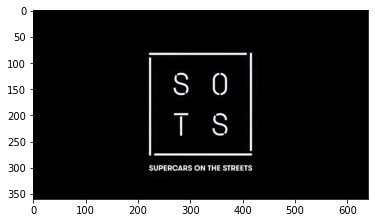

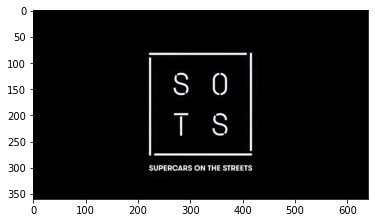

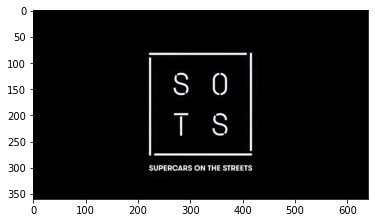

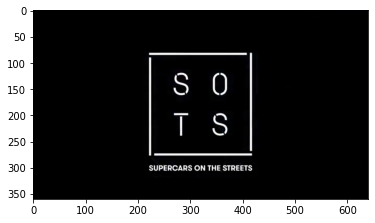

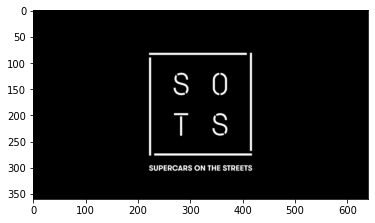

...

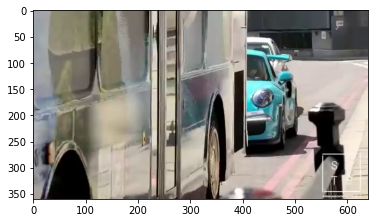

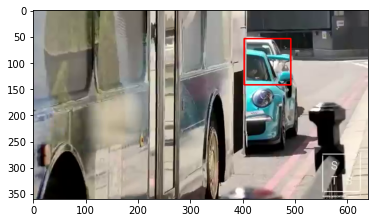

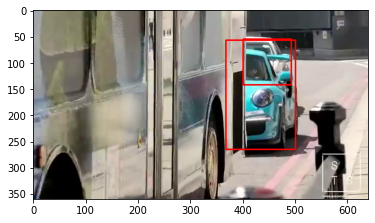

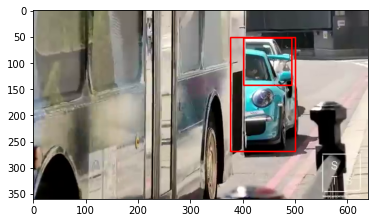

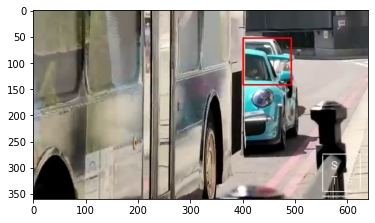

Buffered data was truncated after reaching the output size limit.

In [9]:
# Easy to use car detector that takes an image and ouputs a list of bounding boxes
class CarDetector():
  def __init__(self):
    module_handle = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"
    self.detector = hub.load(module_handle).signatures['default']
  
  def filter_boxes(self, image, boxes, class_names, scores, max_boxes=10, min_score=0.05, class_of_interest='Car'):
    im_height, im_width = image.shape[:2]
    state=[]

    for i in range(min(boxes.shape[0], max_boxes)):
      if scores[i] >= min_score and class_names[i].decode("ascii")==class_of_interest:
        [ymin, xmin, ymax, xmax] = boxes[i]
        (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                  ymin * im_height, ymax * im_height)
        left, right, top, bottom = min(left, right), max(left, right), min(top, bottom), max(top, bottom)
        left, right, top, bottom  = int(left), int(right), int(top), int(bottom) 
        state.append((left, top, right-left, bottom-top))
    return state

  def detect(self, img):
    converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
    result = self.detector(converted_img)

    result = {key:value.numpy() for key,value in result.items()}
    bbox = self.filter_boxes(img, result["detection_boxes"],
        result["detection_class_entities"], result["detection_scores"])
    return bbox


def track_multiple(video, frame, bboxes, output_writer, num_frames=5):
  """
  Tracks object for num_frames frames
  """
  
  # Create a MultiTracker and for each bounding box, add a tracker to it
  # See the documentation for cv::MultiTracker to find the necessary functions
  # < your code here >
  trackers = cv2.MultiTracker_create()
  tracker_type='KCF'
  tracker= create_tracker(tracker_type=tracker_type)
  for bbox in bbboxes:
    cv2.MultiTracker.add(tracker,frame,bboxe)
  for i in range(num_frames):
    ok, frame = video.read()
    if not ok:
        break
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB) # Detector uses RGB, so we will work in this space
    
    # Feed the tracker with a new image and draw a bounding box for each
    # tracked object onto the frame
    # < your code here >

    success, boxes = multiTracker.update(frame)
    for i, newbox in enumerate(boxes):
      p1 = (int(newbox[0]), int(newbox[1]))
      p2 = (int(newbox[0] + newbox[2]), int(newbox[1] + newbox[3]))
      cv2.rectangle(frame, p1, p2, colors[i], 2, 1)

    # show frame
    # cv2.imshow('MultiTracker', frame)
    show_in_row([frame])
    output_writer.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)) # Converting back to BGR, to write correct colors



def detect_object_and_track(path, output_writer, num_frames=300, start_frame=0):
  video = cv2.VideoCapture(path)
  video.set(cv2.CAP_PROP_POS_FRAMES, start_frame)
  ok, frame = video.read()

  try:
   while video.get(cv2.CAP_PROP_POS_FRAMES) < start_frame + num_frames:
      ret, frame = video.read()
      if not ret:
        video.release()
        break
      frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

      state = car_detect.detect(frame)
      if ret:
        for i, newbox in enumerate(state):
          p1 = (int(newbox[0]), int(newbox[1]))
          p2 = (int(newbox[0] + newbox[2]), int(newbox[1] + newbox[3]))
          cv2.rectangle(frame, p1, p2, (255,0,0), 2, 1)

        # show frame
        # cv2.imshow('MultiTracker', frame)
      # cv2.imshow('MultiTracker', frame)
        show_in_row([frame])
        output_writer.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))        
      # If we found objects, draw a bounding box around each detected object,
      # display or write the resulting image and then track all found objects.
      # If nothing was found, display or draw the unchanged image.
      # REMEMBER TO CONVERT BACK TO BGR if you are writing to a video file!
      # < your code here >
      
  except KeyboardInterrupt:
    video.release()

out = cv2.VideoWriter('output_multiple.mp4', cv2.VideoWriter_fourcc('M','J','P','G'), 25, (640, 360))
car_detect = CarDetector()
detect_object_and_track("/content/cars.mp4", out, 750, 160) # start video at 3 min 18 sec, run for 750 frames
out.release()